# CellHint
## SCAID All 
### 24.08.14

In [1]:
import scanpy as sc
import cellhint
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import utils as ut

In [2]:
%config InlineBackend.print_figure_kwargs={'facecolor' : "w"}
%config InlineBackend.figure_format='retina'
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(figsize=(4, 4), dpi=80, facecolor='white')

scanpy==1.10.1 anndata==0.10.7 umap==0.5.5 numpy==1.26.4 scipy==1.13.1 pandas==2.2.2 scikit-learn==1.5.0 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


### load anndata

In [3]:
adata=sc.read_h5ad("SCAID.All.scVI.HVG_seurat_v3_paper.20240814.h5ad")
adata.var_names_make_unique()

In [4]:
adata.X=adata.layers["counts"].copy()

In [5]:
adata.obs.Sample_ID.value_counts().sort_index()

Sample_ID
AA_B0019a      2369
AA_B0024a      2897
AA_B0026a      2696
AA_B0031a      2815
AA_B0032a      2350
               ... 
RAAS_S0016a    2797
RAAS_S0017a    4445
RAAS_S0018a    2706
RAAS_S0019a    3803
RAAS_S0020a    4011
Name: count, Length: 469, dtype: int64

In [6]:
adata

AnnData object with n_obs × n_vars = 1995655 × 38606
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'Sample_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'outlier', 'mt_outlier', 'solo_prediction', 'Library', 'Suspension_Type', 'Donor', 'Age', 'Sex', 'over_clustering', 'CT_Immune_All_Low_majority_voting', 'CT_Immune_All_Low_predicted_labels', 'CT_Adult_Human_Blood_majority_voting', 'CT_Adult_Human_Blood_predicted_labels', 'disease', 'CT_Adult_Human_Skin_majority_voting', 'CT_Adult_Human_Skin_predicted_labels', 'CT_Cells_Intestinal_Tract_majority_voting', 'CT_Cells_Intestinal_Tract_predicted_labels', 'CT_Human_Lung_Atlas_majority_voting', 'CT_Human_Lung_Atlas_predicted_labels',

In [83]:
def create_column_based_on_conditions(df, conditions_list, condition_col, new_col_name):
    """
    Create a new column in the DataFrame based on specified conditions.

    Parameters:
    df (pd.DataFrame): The input DataFrame.
    conditions_list (list): A list of dictionaries where each dictionary has a key as the value to check in the condition column and the value as the column name from which to select values.
    condition_col (str): The column name in which to check the conditions.
    new_col_name (str): The name of the new column to be created.

    Returns:
    pd.DataFrame: The DataFrame with the new column added.
    """
    # Initialize the new column with None
    df[new_col_name] = None

    for condition_dict in conditions_list:
        condition_value = list(condition_dict.keys())[0]
        source_column = condition_dict[condition_value]

        df[new_col_name] = df.apply(
            lambda row: row[source_column] if row[condition_col] == condition_value else row[new_col_name],
            axis=1
        )

    return df

In [7]:
adata.obs.disease.value_counts().sort_index()

disease
Alopecia Areata                19772
Asthma                        373880
Atopic Dermatitis             304422
Cardiovascular Diseases        72333
Chronic Kidney Disease        200882
Inflammatory Bowel Disease    132563
Interstitial Lung Disease     186831
MAFLD/MASH                    130514
Multiple Sclerosis            233236
Nasal Polyp                    34364
Pediatric IBD                 116221
Psoriasis                     103963
Rheumatoid Arthritis           86674
Name: count, dtype: int64

In [8]:
adata

AnnData object with n_obs × n_vars = 1995655 × 38606
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'Sample_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'outlier', 'mt_outlier', 'solo_prediction', 'Library', 'Suspension_Type', 'Donor', 'Age', 'Sex', 'over_clustering', 'CT_Immune_All_Low_majority_voting', 'CT_Immune_All_Low_predicted_labels', 'CT_Adult_Human_Blood_majority_voting', 'CT_Adult_Human_Blood_predicted_labels', 'disease', 'CT_Adult_Human_Skin_majority_voting', 'CT_Adult_Human_Skin_predicted_labels', 'CT_Cells_Intestinal_Tract_majority_voting', 'CT_Cells_Intestinal_Tract_predicted_labels', 'CT_Human_Lung_Atlas_majority_voting', 'CT_Human_Lung_Atlas_predicted_labels',

In [14]:
conditions_list =[
    {'Alopecia Areata':'CT_Immune_All_Low_majority_voting'},
    {'Asthma':'CT_Immune_All_Low_majority_voting'},
    {'Atopic Dermatitis':'CT_Adult_Human_Skin_majority_voting'},
    {'Cardiovascular Diseases':'CT_Immune_All_Low_majority_voting'},
    {'Chronic Kidney Disease':'CT_Adult_Human_Kidney_majority_voting'},
    {'Inflammatory Bowel Disease':'CT_Cells_Intestinal_Tract_majority_voting'},
    {'Interstitial Lung Disease':'CT_Human_Lung_Atlas_majority_voting'},
    {'MAFLD/MASH':'CT_Immune_All_Low_majority_voting'},
    {'Multiple Sclerosis':'CT_Immune_All_Low_majority_voting'},
    {'Nasal Polyp':'CT_Human_Lung_Atlas_majority_voting'},
    {'Pediatric IBD':'CT_Cells_Intestinal_Tract_majority_voting'},
    {'Psoriasis':'CT_Adult_Human_Skin_majority_voting'},
    {'Rheumatoid Arthritis':'CT_Immune_All_Low_majority_voting'},
]

In [15]:
adata.obs=create_column_based_on_conditions(adata.obs, conditions_list, 'disease', 'Per_Disease_CT_Annotation')

... storing 'Per_Disease_CT_Annotation' as categorical


the obs value 'Per_Disease_CT_Annotation' has more than 103 categories. Uniform 'grey' color will be used for all categories.


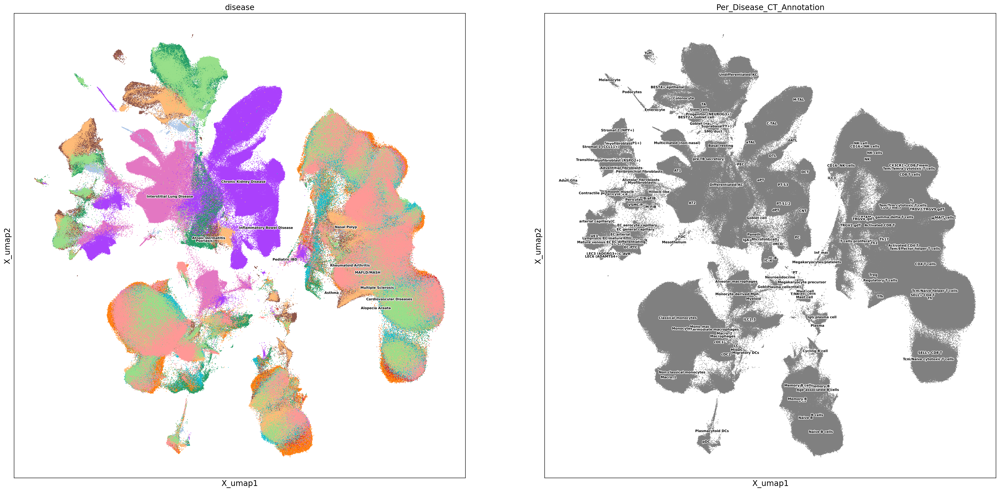

In [16]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata, basis='X_umap', 
                color=['disease','Per_Disease_CT_Annotation'],
                legend_loc='on data',
                legend_fontsize=6,
                legend_fontoutline=2,
                size=5)

In [21]:
adata.obs["leiden_100"].value_counts()

leiden_100
0     209018
1     206289
2     182551
3     177006
4      92040
5      81460
6      81074
7      70334
8      60259
9      53988
10     53498
11     52337
12     47688
13     43796
14     39721
15     38202
16     36256
17     35959
18     34150
19     30956
20     26478
21     25458
22     24752
23     23944
24     23800
25     23546
26     22981
27     21698
28     20959
29     17799
30     14987
31     14889
32     14029
33     11502
34     10615
35      8934
36      8085
37      6726
38      6348
39      5627
40      5026
41      4402
42      4083
43      3868
44      3842
45      3809
46      2788
47      2045
48      1790
49      1584
50      1288
51      1147
52       126
53        55
54        20
55        18
56        17
57         8
Name: count, dtype: int64

In [ ]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['leiden_100',],
                legend_loc='on data',
                legend_fontsize=12,
                legend_fontoutline=4,
                frameon=False,
                ncols=1,
                size=5)

In [ ]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['leiden_200',],
                legend_loc='on data',
                legend_fontsize=12,
                legend_fontoutline=4,
                frameon=False,
                ncols=1,
                size=5)

In [ ]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['leiden_300',],
                legend_loc='on data',
                legend_fontsize=12,
                legend_fontoutline=4,
                frameon=False,
                ncols=1,
                size=5)

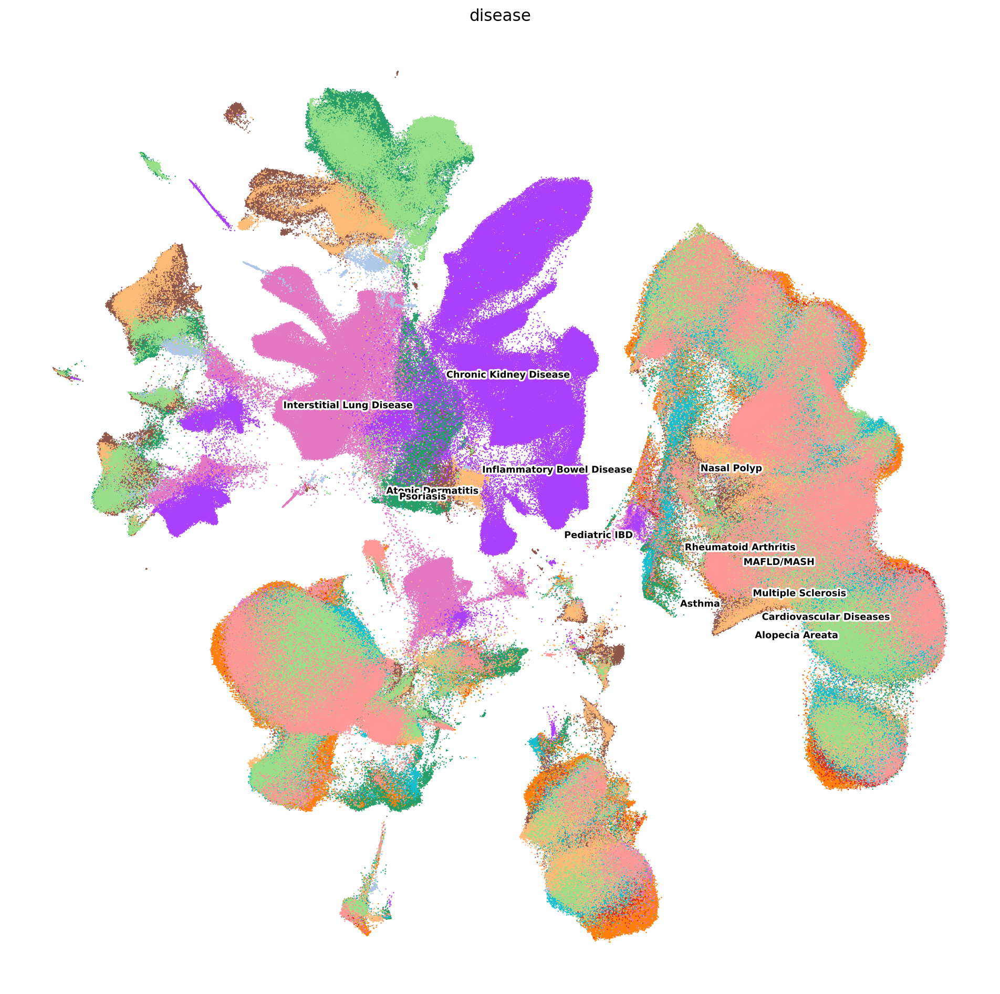

In [85]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['disease',],
                legend_loc='on data',
                legend_fontsize=8,
                legend_fontoutline=3,
                frameon=False,
                ncols=1,
                size=5)

In [46]:
df=adata.obs
# Calculate the percentage of Per_Disease_CT_Annotation categories per category
percentage_df = df.groupby('leiden_100')['Per_Disease_CT_Annotation'].value_counts(normalize=True).rename('percentage').mul(100).reset_index()

# Get the top 5 Per_Disease_CT_Annotation categories per leiden_300 category
top_5_df = percentage_df.groupby('leiden_100').apply(lambda x: x.nlargest(5, 'percentage')).reset_index(drop=True)
top_1_df = percentage_df.groupby('leiden_100').apply(lambda x: x.nlargest(1, 'percentage')).reset_index(drop=True)

top_1_df.to_csv("leiden_100_Top1_PerDisease.csv")
top_5_df.to_csv("leiden_100_Top5_PerDisease.csv")

/tmp/ipykernel_44675/1270350988.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  percentage_df = df.groupby('leiden_100')['Per_Disease_CT_Annotation'].value_counts(normalize=True).rename('percentage').mul(100).reset_index()
/tmp/ipykernel_44675/1270350988.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  top_5_df = percentage_df.groupby('leiden_100').apply(lambda x: x.nlargest(5, 'percentage')).reset_index(drop=True)
/tmp/ipykernel_44675/1270350988.py:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping

In [47]:
df=adata.obs
# Calculate the percentage of Per_Disease_CT_Annotation categories per category
percentage_df = df.groupby('leiden_300')['Per_Disease_CT_Annotation'].value_counts(normalize=True).rename('percentage').mul(100).reset_index()

# Get the top 5 Per_Disease_CT_Annotation categories per leiden_300 category
top_5_df = percentage_df.groupby('leiden_300').apply(lambda x: x.nlargest(5, 'percentage')).reset_index(drop=True)
top_1_df = percentage_df.groupby('leiden_300').apply(lambda x: x.nlargest(1, 'percentage')).reset_index(drop=True)

top_1_df.to_csv("leiden_300_Top1_PerDisease.csv")
top_5_df.to_csv("leiden_300_Top5_PerDisease.csv")

/tmp/ipykernel_44675/4275959003.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  percentage_df = df.groupby('leiden_300')['Per_Disease_CT_Annotation'].value_counts(normalize=True).rename('percentage').mul(100).reset_index()
/tmp/ipykernel_44675/4275959003.py:6: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  top_5_df = percentage_df.groupby('leiden_300').apply(lambda x: x.nlargest(5, 'percentage')).reset_index(drop=True)
/tmp/ipykernel_44675/4275959003.py:6: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping

In [20]:
adata.obs["disease"].value_counts().sort_index()

disease
Alopecia Areata                19772
Asthma                        373880
Atopic Dermatitis             304422
Cardiovascular Diseases        72333
Chronic Kidney Disease        200882
Inflammatory Bowel Disease    132563
Interstitial Lung Disease     186831
MAFLD/MASH                    130514
Multiple Sclerosis            233236
Nasal Polyp                    34364
Pediatric IBD                 116221
Psoriasis                     103963
Rheumatoid Arthritis           86674
Name: count, dtype: int64

In [69]:
adata.obs['Cell_Type_Level_1']=adata.obs['leiden_100']
adata.obs['Cell_Type_Level_2']=adata.obs['leiden_100']

In [70]:
level_1={'0':'Immune Lymphoid',
'1':'Immune Myeloid',
'2':'Immune Lymphoid',
'3':'Immune Lymphoid',
'4':'Immune Lymphoid',
'5':'Immune Lymphoid',
'6':'Immune Lymphoid',
'7':'Immune Myeloid',
'8':'Epithelium',
'9':'Epithelium',
'10':'Immune Lymphoid',
'11':'Immune Lymphoid',
'12':'Epithelium',
'13':'Epithelium',
'14':'Epithelium',
'15':'Immune Lymphoid',
'16':'Stromal',
'17':'Epithelium',
'18':'Epithelium',
'19':'Epithelium',
'20':'Epithelium',
'21':'Immune Lymphoid',
'22':'Immune Myeloid',
'23':'Immune Lymphoid',
'24':'Immune Myeloid',
'25':'Stromal',
'26':'Stromal',
'27':'Stromal',
'28':'Immune Myeloid',
'29':'Epithelium',
'30':'Epithelium',
'31':'Immune Myeloid',
'32':'Epithelium',
'33':'Immune Lymphoid',
'34':'Epithelium',
'35':'Epithelium',
'36':'Epithelium',
'37':'Immune Myeloid',
'38':'Epithelium',
'39':'Epithelium',
'40':'Immune Myeloid',
'41':'Immune Lymphoid',
'42':'Epithelium',
'43':'Immune Lymphoid',
'44':'Epithelium',
'45':'Immune Myeloid',
'46':'Immune Lymphoid',
'47':'Epithelium',
'48':'Epithelium',
'49':'Stromal',
'50':'Stromal',
'51':'Stromal',
'52':'Epithelium',
'53':'Epithelium',
'54':'Epithelium',
'55':'Epithelium',
'56':'Immune Myeloid',
'57':'Stromal',}

In [71]:
level_2={'0':'Immune NKT Lymphoid',
'1':'Immune Myeloid',
'2':'Immune NKT Lymphoid',
'3':'Immune NKT Lymphoid',
'4':'Immune NKT Lymphoid',
'5':'Immune B Lymphoid',
'6':'Immune NKT Lymphoid',
'7':'Immune Myeloid',
'8':'Epithelium',
'9':'Epithelium',
'10':'Immune B Lymphoid',
'11':'Immune NKT Lymphoid',
'12':'Epithelium',
'13':'Epithelium',
'14':'Epithelium',
'15':'Immune NKT Lymphoid',
'16':'Fibroblast Lineage',
'17':'Epithelium',
'18':'Epithelium',
'19':'Epithelium',
'20':'Epithelium',
'21':'Immune NKT Lymphoid',
'22':'Immune Myeloid',
'23':'Immune NKT Lymphoid',
'24':'Immune Myeloid',
'25':'Fibroblast Lineage',
'26':'Endothelium',
'27':'Endothelium',
'28':'Immune Myeloid',
'29':'Epithelium',
'30':'Epithelium',
'31':'Immune Myeloid',
'32':'Epithelium',
'33':'Immune NKT Lymphoid',
'34':'Epithelium',
'35':'Epithelium',
'36':'Epithelium',
'37':'Immune Myeloid',
'38':'Epithelium',
'39':'Epithelium',
'40':'Immune Myeloid',
'41':'Immune NKT Lymphoid',
'42':'Epithelium',
'43':'Immune B Lymphoid',
'44':'Epithelium',
'45':'Immune Myeloid',
'46':'Immune B Lymphoid',
'47':'Epithelium',
'48':'Epithelium',
'49':'Stromal',
'50':'Mesothelium',
'51':'Endothelial Lymphatic',
'52':'Epithelium',
'53':'Epithelium',
'54':'Epithelium',
'55':'Epithelium',
'56':'Immune Myeloid',
'57':'Stromal',}

In [72]:
adata.obs['Cell_Type_Level_1'] = (adata.obs['leiden_100'].map(level_1).astype('category'))
adata.obs['Cell_Type_Level_2'] = (adata.obs['leiden_100'].map(level_2).astype('category'))

adata.obs.loc[adata.obs['leiden_300'] == "60", 'Cell_Type_Level_1'] = "Immune Lymphoid"
adata.obs.loc[adata.obs['leiden_300'] == "60", 'Cell_Type_Level_2'] = "Immune B Lymphoid"

In [73]:
adata.obs["disease"].value_counts().sort_index()

disease
Alopecia Areata                19772
Asthma                        373880
Atopic Dermatitis             304422
Cardiovascular Diseases        72333
Chronic Kidney Disease        200882
Inflammatory Bowel Disease    132563
Interstitial Lung Disease     186831
MAFLD/MASH                    130514
Multiple Sclerosis            233236
Nasal Polyp                    34364
Pediatric IBD                 116221
Psoriasis                     103963
Rheumatoid Arthritis           86674
Name: count, dtype: int64

In [74]:
adata.obs["Cell_Type_Level_1"].value_counts().sort_index()

Cell_Type_Level_1
Epithelium          465210
Immune Lymphoid    1045336
Immune Myeloid      376601
Stromal             108508
Name: count, dtype: int64

In [75]:
adata.obs["Cell_Type_Level_2"].value_counts().sort_index()

Cell_Type_Level_2
Endothelial Lymphatic      1147
Endothelium               44679
Epithelium               465210
Fibroblast Lineage        59802
Immune B Lymphoid        147804
Immune Myeloid           376601
Immune NKT Lymphoid      897532
Mesothelium                1288
Stromal                    1592
Name: count, dtype: int64

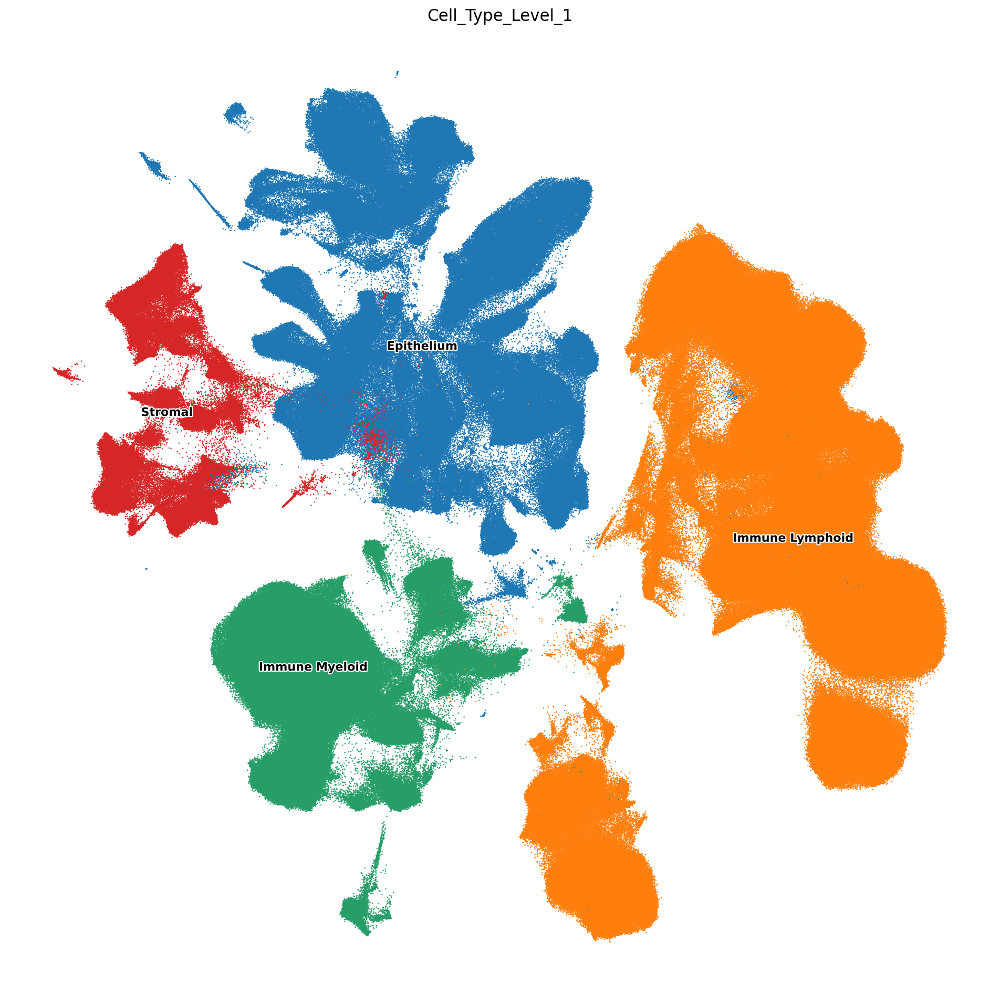

In [76]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['Cell_Type_Level_1'],
                legend_loc='on data',
                legend_fontsize=10,
                legend_fontoutline=2,
                ncols=1,
                frameon=False,
                size=5)

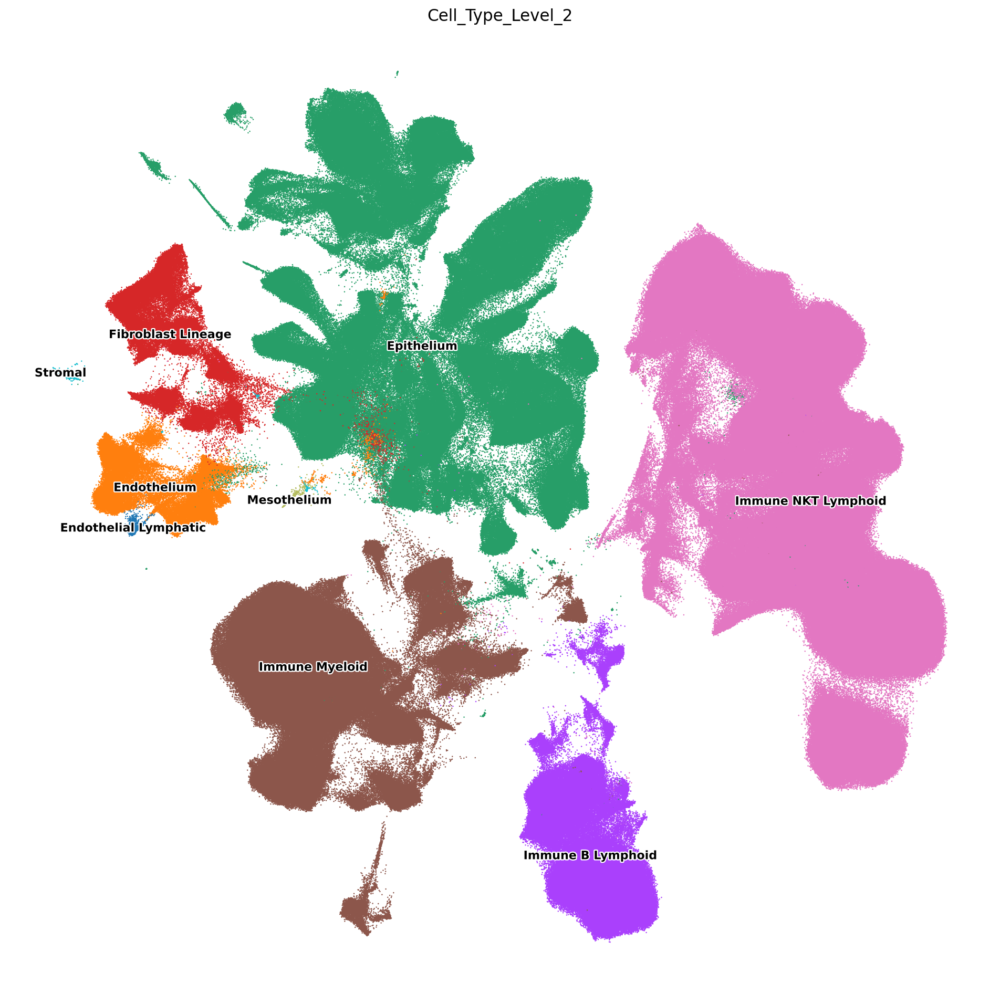

In [77]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['Cell_Type_Level_2'],
                legend_loc='on data',
                legend_fontsize=10,
                legend_fontoutline=2,
                ncols=1,
                frameon=False,
                size=5)

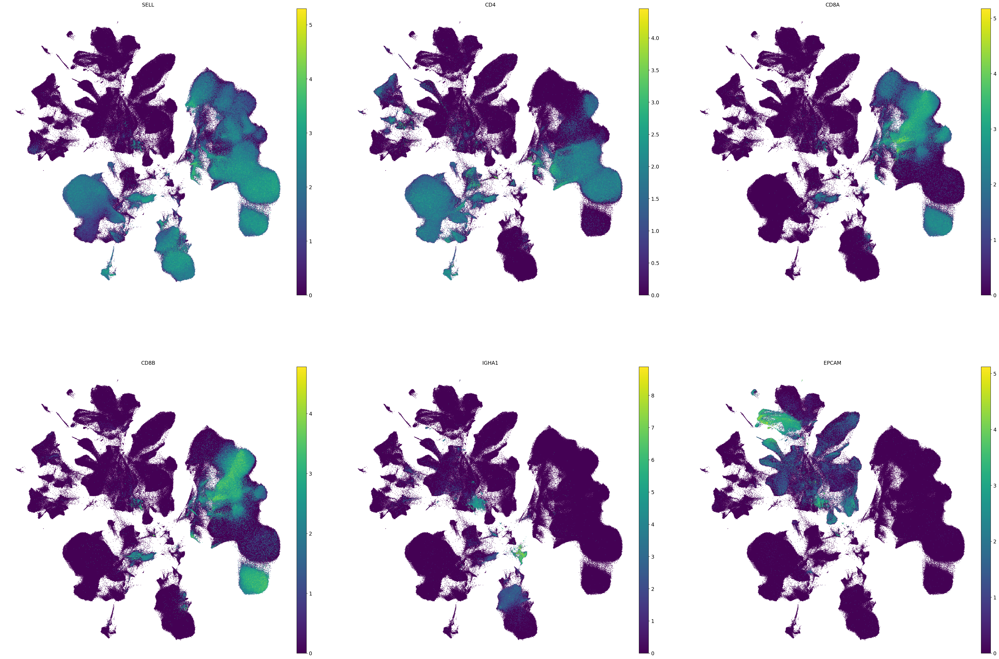

In [32]:
plt.rcParams["figure.figsize"] = [15,15]
sc.pl.embedding(adata,
                basis='X_scvi_umap', 
                color=['SELL','CD4','CD8A','CD8B','IGHA1','EPCAM'],
                legend_loc='on data',
                legend_fontsize=10,
                legend_fontoutline=2,
                ncols=3,
                frameon=False,
                layer='CP10K',
                size=5)

In [33]:
adata

AnnData object with n_obs × n_vars = 1995655 × 38606
    obs: 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'Sample_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'n_genes', 'outlier', 'mt_outlier', 'solo_prediction', 'Library', 'Suspension_Type', 'Donor', 'Age', 'Sex', 'over_clustering', 'CT_Immune_All_Low_majority_voting', 'CT_Immune_All_Low_predicted_labels', 'CT_Adult_Human_Blood_majority_voting', 'CT_Adult_Human_Blood_predicted_labels', 'disease', 'CT_Adult_Human_Skin_majority_voting', 'CT_Adult_Human_Skin_predicted_labels', 'CT_Cells_Intestinal_Tract_majority_voting', 'CT_Cells_Intestinal_Tract_predicted_labels', 'CT_Human_Lung_Atlas_majority_voting', 'CT_Human_Lung_Atlas_predicted_labels',

In [78]:
## Save Anndata
adata.write_h5ad("SCAID.All.scVI.level.{t}.h5ad".format(t=20240814))

In [79]:
adata.obs["Cell_Type_Level_1"].value_counts().sort_index()

Cell_Type_Level_1
Epithelium          465210
Immune Lymphoid    1045336
Immune Myeloid      376601
Stromal             108508
Name: count, dtype: int64

In [80]:
adata.obs["Cell_Type_Level_2"].value_counts().sort_index()

Cell_Type_Level_2
Endothelial Lymphatic      1147
Endothelium               44679
Epithelium               465210
Fibroblast Lineage        59802
Immune B Lymphoid        147804
Immune Myeloid           376601
Immune NKT Lymphoid      897532
Mesothelium                1288
Stromal                    1592
Name: count, dtype: int64

# 02. CellHint Harmonize Annotations

In [ ]:
?cellhint.harmonize

In [ ]:
%%time
alignment = cellhint.harmonize(adata, 'disease', 'Per_Disease_CT_Annotation')

In [ ]:
alignment.relation.head(30)

In [ ]:
alignment.reannotation

In [ ]:
adata.obs[['low_hierarchy', 'high_hierarchy']] = alignment.reannotation.loc[adata.obs_names, ['reannotation', 'group']]
adata_save.obs[['low_hierarchy', 'high_hierarchy']] = alignment.reannotation.loc[adata.obs_names, ['reannotation', 'group']]

In [ ]:
alignment.base_distance

In [ ]:
alignment.base_distance.assignment

In [ ]:
dist_mat = alignment.base_distance.to_meta()
dist_mat.iloc[:5, :5]

In [ ]:
member_mat = alignment.base_distance.to_meta(turn_binary = True)
member_mat.iloc[:5, :5]

In [ ]:
import seaborn as sns
sns.clustermap(member_mat, figsize=(20, 20))

In [ ]:
cellhint.treeplot(alignment)

In [ ]:
cellhint.treeplot(alignment, order_dataset = True)

In [ ]:
adata

In [ ]:
sc.pl.embedding(adata_save, 
                basis='X_scvi_umap', 
                color=['low_hierarchy', 'high_hierarchy'],
                ncols=1,
                size=5,
                legend_loc='on data',
                legend_fontsize=5,
                legend_fontoutline=1
               )

In [ ]:
## Save Anndata
adata_save.write_h5ad("SCAID.All.scVI.cellhint.{t}.h5ad".format(t=20240731))

In [ ]:
adata_save.obs.low_hierarchy.value_counts()